# Analysis Uber data 2014 in New York City

**Author:**

***Robby Hidayah Ramadhan***

## DATA 

you can download the data from [kaggle](https://www.kaggle.com/fivethirtyeight/uber-pickups-in-new-york-city).

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

sns.set_style('whitegrid')
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

## IMPORT DATASET

#### What I do:

I am prepare dataset for the analysis. I dont use all the data, but i only use raw data uber from apr2014 - sep2014.

In [2]:
files=os.listdir(r'C:\Users\Robby\Project\Project\Project-III\Dataset\uber-pickups-in-new-york-city')[-7:]
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [3]:
# i dont need data in 2015, so i remove this.
files.remove('uber-raw-data-janjune-15.csv')


# combine data to one dataframe
Filepath = r'C:/Users/Robby/Project/Project/Project-III/Dataset/uber-pickups-in-new-york-city'
raw_df = pd.DataFrame()

for i in files:
    df = pd.read_csv(Filepath+'/'+i,encoding='utf-8')
    raw_df = pd.concat([df,raw_df])

In [4]:
raw_df.head()

,Date/Time,Lat,Lon,Base
0,9/1/2014 0:01:00,40.2201,-74.0021,B02512
1,9/1/2014 0:01:00,40.7500,-74.0027,B02512
2,9/1/2014 0:03:00,40.7559,-73.9864,B02512
3,9/1/2014 0:06:00,40.7450,-73.9889,B02512
4,9/1/2014 0:11:00,40.8145,-73.9444,B02512


In [5]:
raw_df.shape

(4534327, 4)

#### __The Information I Get:__

* There is 4.534.327 rows and 4 column data

* __There are 4 files of raw data on Uber pickups in New York City from April to September 2014. The files are separated by month and each has the following columns:__

   * __Date/Time__ : The date and time of the Uber pickup

   * __Lat__ : The latitude of the Uber pickup

   * __Lon__ : The longitude of the Uber pickup

   * __Base__ : The TLC base company code affiliated with the Uber pickup


## DATA PREPARATION

#### What I Do:
    * Check wheter is missing value in df
    * Check datatype
    * add new column, to make analysis easier

In [6]:
df = raw_df.copy()

*Check missing value*

In [7]:
df.isnull().sum()

Date/Time    0
Lat          0
Lon          0
Base         0
dtype: int64

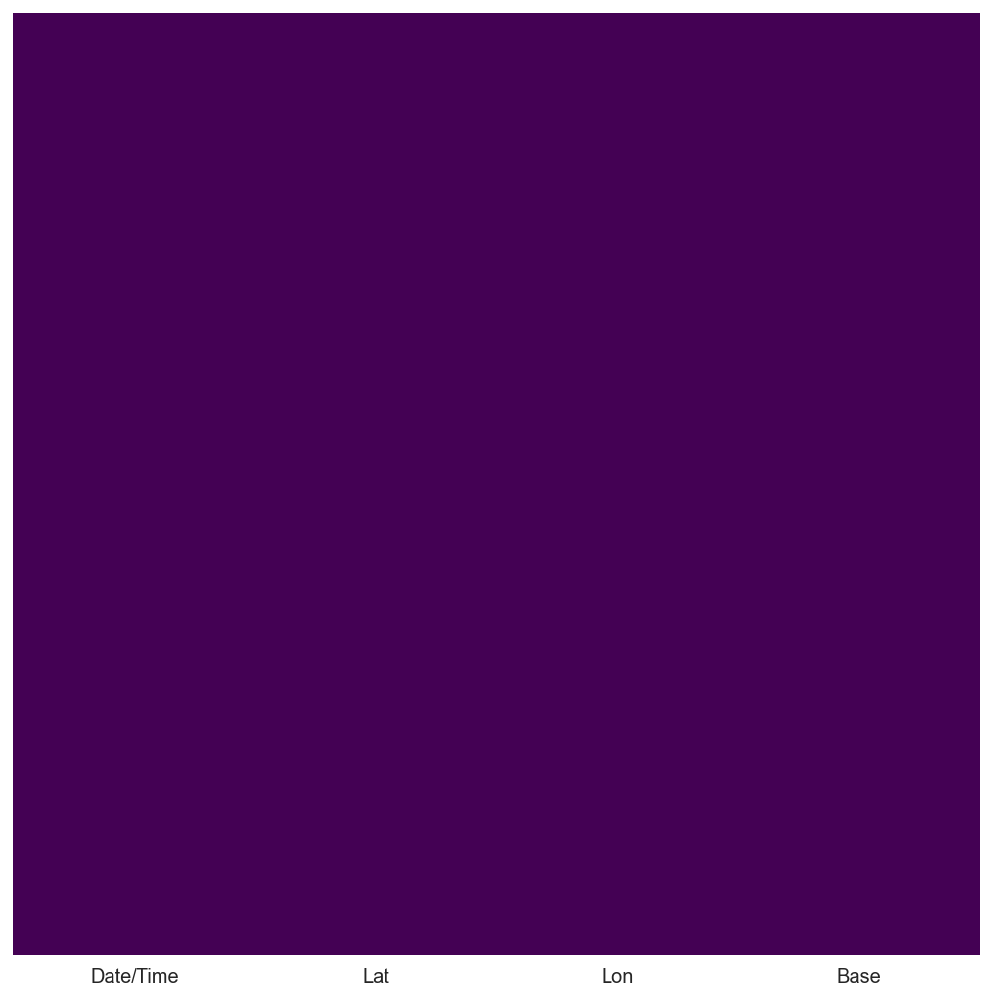

In [8]:
plt.figure(figsize=(9,9))
sns.heatmap(df.isnull(), annot=False, cbar=False, yticklabels=False, cmap='viridis')
plt.show()

*Checking Datatype*

In [9]:
 df.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

####  __Problem & Solution:__

**column *Date/time*** This data is still of object data type because pandas by default assign this date time as your objective to type.

But we know this data and support some timestamp format.
It means we have to convert this. And i have to __convert this data into some timestamp format.__

In [10]:
df['Date/Time'] = pd.to_datetime( df['Date/Time'], format='%m/%d/%Y %H:%M:%S')

df.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
dtype: object

*Add New Column*

In [11]:
df.head()

,Date/Time,Lat,Lon,Base
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512


#### What I Do in The Next Step:
* I will __make a new column__ to clarify the information from *Date/time* column.

In [12]:
# Create New Column
df['Weekday'] = df['Date/Time'].dt.day_name()
df['Day'] = df['Date/Time'].dt.day
df['Month'] = df['Date/Time'].dt.month
df['Minute'] = df['Date/Time'].dt.minute
df['Hour'] = df['Date/Time'].dt.hour

In [13]:
df

,Date/Time,Lat,Lon,Base,Weekday,Day,Month,Minute,Hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,9,1,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,9,1,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,9,3,0
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,9,6,0
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,9,11,0
...,...,...,...,...,...,...,...,...,...
564511,2014-04-30 23:22:00,40.7640,-73.9744,B02764,Wednesday,30,4,22,23
564512,2014-04-30 23:26:00,40.7629,-73.9672,B02764,Wednesday,30,4,26,23
564513,2014-04-30 23:31:00,40.7443,-73.9889,B02764,Wednesday,30,4,31,23
564514,2014-04-30 23:32:00,40.6756,-73.9405,B02764,Wednesday,30,4,32,23


## ANALYZING OF MONTHLY TOTAL UBER TRIP

#### What I Do:


In this dataset we have the *'Month'* feature, and I will use it to find out:
* __which month the uber trip is highest or lowest__

In [14]:
df.head()

,Date/Time,Lat,Lon,Base,Weekday,Day,Month,Minute,Hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,9,1,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,9,1,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,9,3,0
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,9,6,0
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,9,11,0


In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4534327 entries, 0 to 564515
Data columns (total 9 columns):
 #   Column     Dtype         
---  ------     -----         
 0   Date/Time  datetime64[ns]
 1   Lat        float64       
 2   Lon        float64       
 3   Base       object        
 4   Weekday    object        
 5   Day        int64         
 6   Month      int64         
 7   Minute     int64         
 8   Hour       int64         
dtypes: datetime64[ns](1), float64(2), int64(4), object(2)
memory usage: 345.9+ MB


In [16]:
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [17]:
trace1 = go.Bar( 
        x = df.groupby('Month')['Hour'].sum().index,
        y = df.groupby('Month')['Hour'].sum(),
        name= 'Priority')
ax = iplot([trace1])

__The Information What I Get:__

* The highest Uber trips occurred in September. it has 2 times the number of uber trips in april
* Getting to the end of the year, the higher the uber trip chart

## ANALYZING OF TOTAL TRIP UBER PER DAY IN 2014

#### What I Do Is:

I want to know which day the uber trip where highest. And i will use 2 method.
* First method, to know journey of each Day in uber
* Second method to know number of rides per day of the week

In [18]:
import plotly.express as px

Text(0.5, 1.0, 'UBER TRIP TOTAL ANALYSIS BY DATE ')

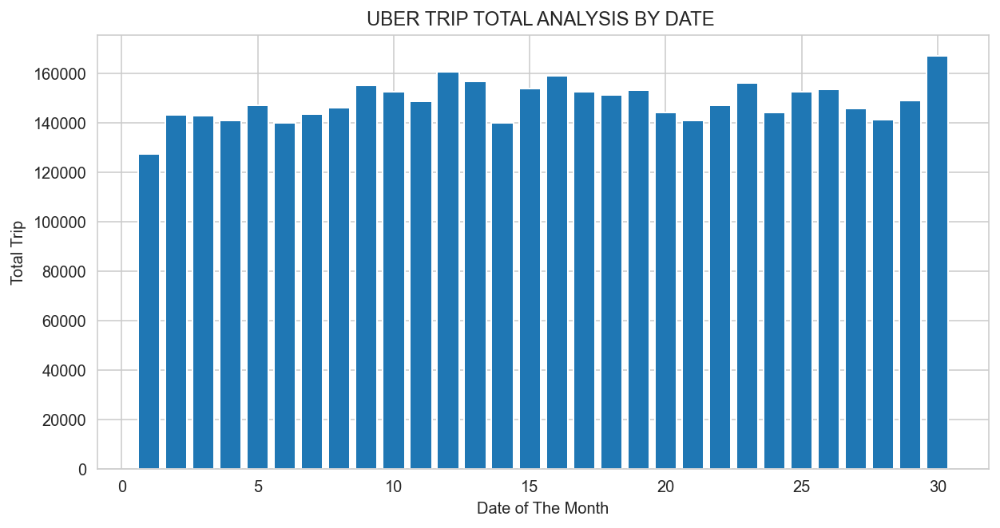

In [19]:
# plt.figure = wadah bingkai 
# METHOD 1

plt.figure(figsize=(10,5))
plt.hist(df['Day'], bins=30, rwidth=0.8, range=(0.5,30.5))
plt.xlabel('Date of The Month')
plt.ylabel('Total Trip')
plt.title('UBER TRIP TOTAL ANALYSIS BY DATE ')

In [20]:
x=df['Weekday'].value_counts().sort_values()
index_X = x.index
value_Y = x

px.bar(x=index_X,
      y=value_Y, title='UBER TRIP TOTAL IN WEEKDAYS')

#### __The Information What I Get :__
* The highest number of trips is found in Thursday, that is 755.145K trips
* The lowers number of trips is found in sunday, that is 490.18K trips
* Uber trips are rising on the working days and decreases on the weekends. On Sunday, the Uber trips are the lowest and on Mondays, they are the highest
* Uber travels are used the most to go to work than to go on outing

## ANALYZING OF TOTAL UBER TRIP IN DAY PER EACH MONTH

#### What I Do Is:

To Find out:
* graph of the total uber trips in each month
* characteristics *total trip uber* in each month

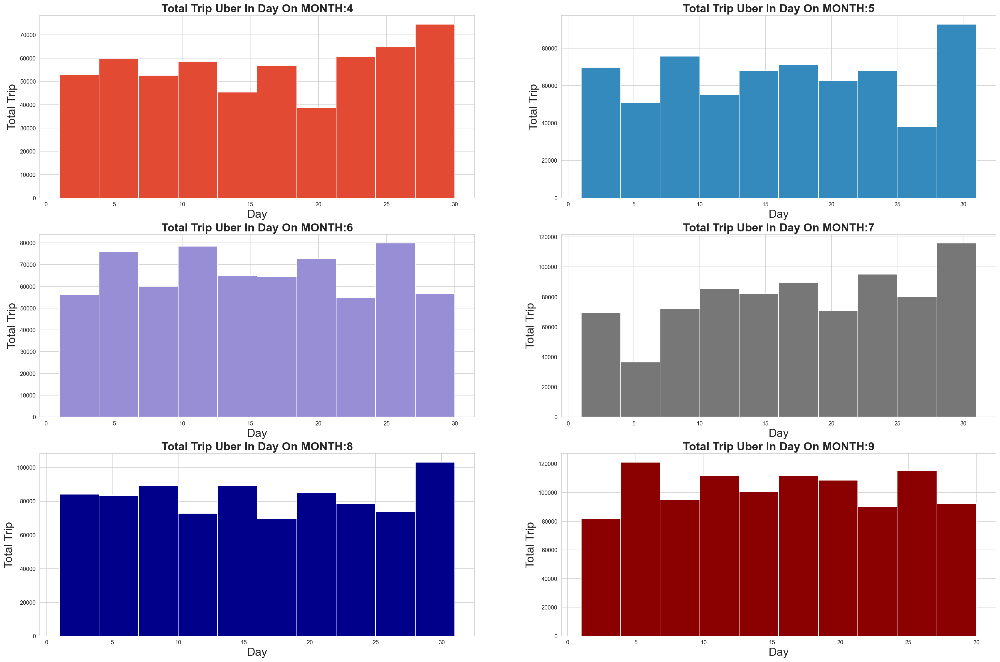

In [21]:
monthData = df['Month'].value_counts().index
monthData_Sort = monthData.sort_values()

plt.figure(figsize=(30,20))
colors = ["#e24a33", "#348abd", "#988ed5", "#777777", 'darkblue', 'darkred']
sns.set_style('whitegrid')

for i, month in enumerate(monthData_Sort):
    plt.subplot(3,2, i+1)
    x = df[df['Month'] == month]
    plt.hist(x['Day'], color= colors[i], label=month )
    plt.xlabel('Day',fontsize=20)
    plt.ylabel('Total Trip', fontsize=20)
    plt.title('Total Trip Uber In Day On MONTH:' + str(month), fontweight = 'bold', fontsize=20)

#### __The Information What I Get__:
* most of the **highest** total trips are obtained __on the date near the end of the month__

## ANALYZING OF TOTAL TRIP UBER IN HOUR PER EACH MONTH

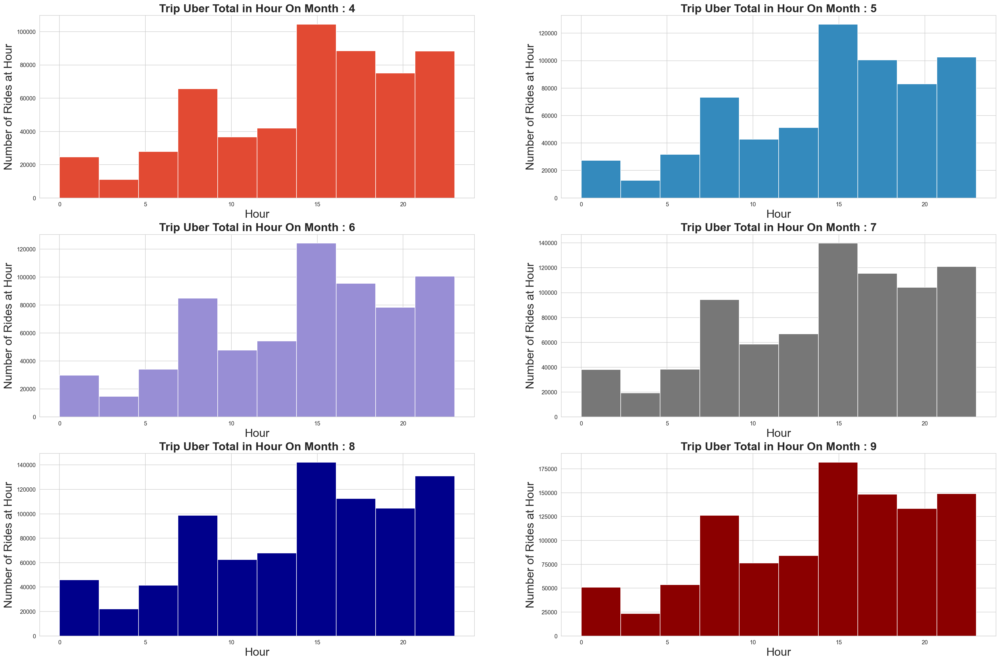

In [22]:
# i = index, dibutuhkan sebagai parameter subplot
# looping digunakan agar masing masing bulan dibuat plotnya, 6 bulan = 6 plot
# df['month']== month akan return true false, agar diplotting sesuai urutan nya dari bulan 4 - 9

monthData = df['Month'].value_counts().index
monthSort = monthData.sort_values()


plt.figure(figsize=(30,20))
colors = ["#e24a33", "#348abd", "#988ed5", "#777777", 'darkblue', 'darkred']
sns.set_style('whitegrid'
             )
for i,month in enumerate(monthSort):
    plt.subplot(3,2, i+1)
    x = df[df['Month']== month]['Hour'].hist(color= colors[i], label=month)
    
    plt.xlabel('Hour', fontsize=20)
    plt.ylabel('Number of Rides at Hour',fontsize=20)
    plt.title('Trip Uber Total in Hour On Month : '+str(month),fontweight ="bold", fontsize=20)

#### __The Information What I Get:__

* Almost every month, **the peak time** of the number of trips **occurs in the afternoon**

## ANALYZING TRIP PER HOUR IN 2014

C:\Users\Robby\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



Text(0.5, 0, 'Hour')

<Figure size 1440x720 with 0 Axes>

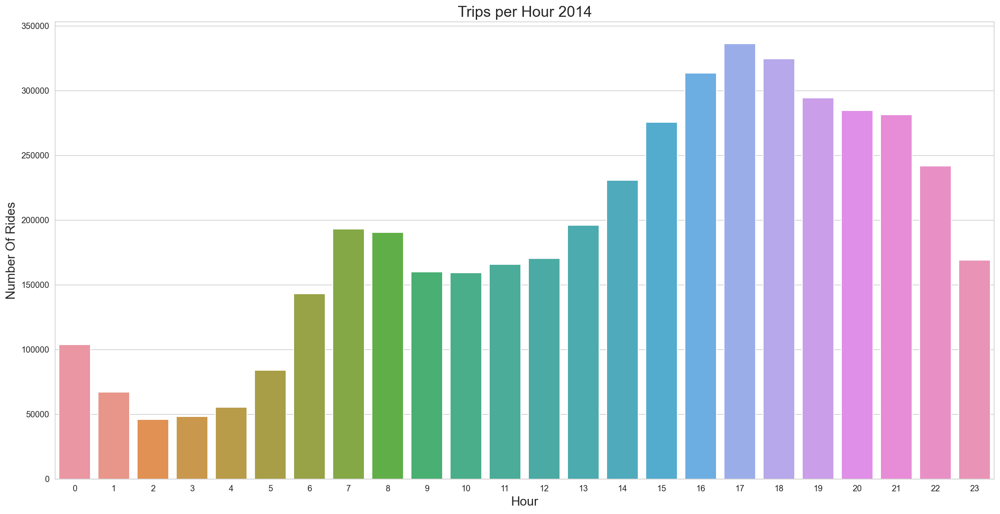

In [23]:
plt.figure(figsize=(20,10))

plt.figure(figsize=(20,10))
ax=sns.countplot(df['Hour'])
ax.set_title('Trips per Hour 2014', fontsize = 18)
ax.set_ylabel('Number Of Rides', fontsize = 15)
ax.set_xlabel ('Hour', fontsize = 15)

#### __The Information What I Get:__

* The Uber trips decreases after midnight and then start increasing after 5 am
* The peak of the number of rides in new york occurs at 17.00, followed by 18.00 and decreasing over time

Text(0.5, 1.0, 'Hours of day VS Latitude Location')

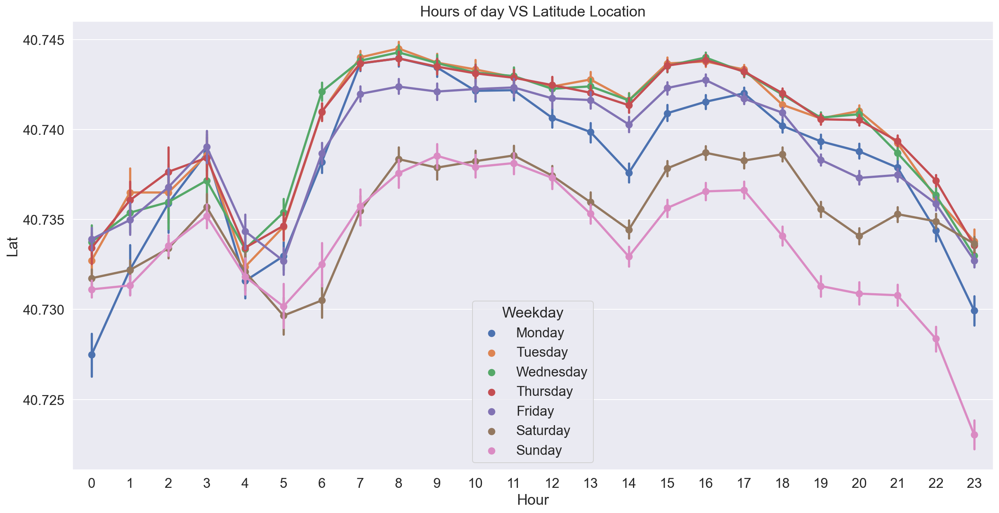

In [24]:
# point plots can be more useful than bar plots for focusing comparisons between different levels of one or more categorical variables
plt.figure(figsize=(20,10))
sns.set(font_scale=1.5)

ax = sns.pointplot(x= df['Hour'], y=df['Lat'], hue=df['Weekday'])
ax.set_title('Hours of day VS Latitude Location')

## ANALYSE WHICH BASE NUMBER GETS POPULAR BY MONTH NAME

In [25]:
df.head()

,Date/Time,Lat,Lon,Base,Weekday,Day,Month,Minute,Hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,9,1,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,9,1,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,9,3,0
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,9,6,0
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,9,11,0


In [26]:
df_for_base = df.groupby(['Base','Month'])['Date/Time'].count().reset_index()
df_for_base.head()

,Base,Month,Date/Time
0,B02512,4,35536
1,B02512,5,36765
2,B02512,6,32509
3,B02512,7,35021
4,B02512,8,31472


<AxesSubplot:xlabel='Month', ylabel='Date/Time'>

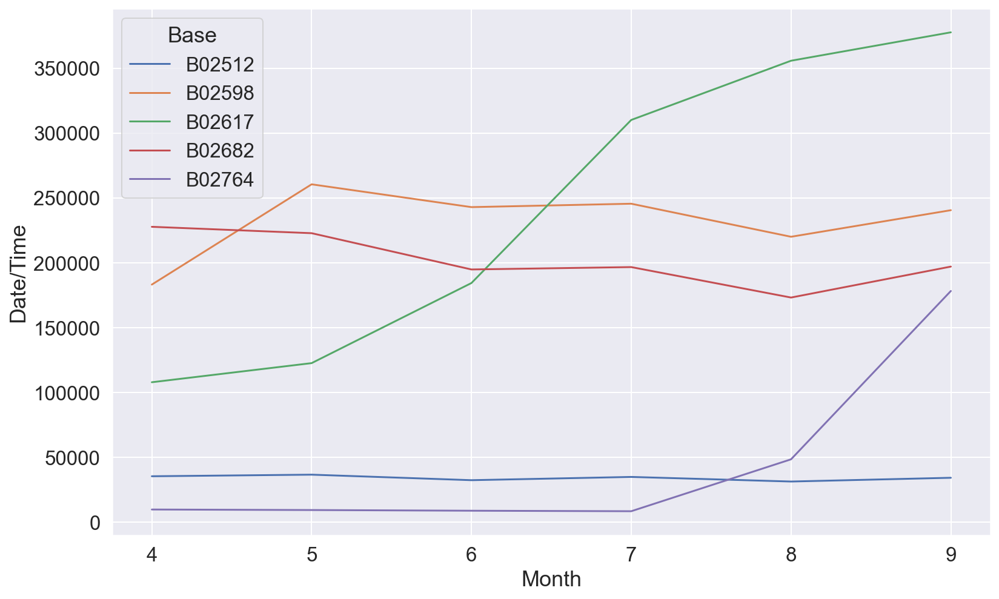

In [27]:
# Line plots can be used on datasets that have continuous values to see the movement of data over time.
#lineplot, x,y,hue,

plt.figure(figsize=(13,8))
sns.set(font_scale=1.5)

sns.lineplot(x='Month', y='Date/Time', hue='Base', data= df_for_base)

## Heatmap by Weekday and Hour

#### What I Do:
**Creating pivot tables**
* using groupby on 2 columns so 'Weekday' become rows and 'hour' become cols

**Define Heatmap Functions, so that it can be easily visualize**

In [28]:
def count_rows(rows):
    return len(rows)

In [29]:
by_cross = df.groupby(['Weekday', 'Hour']).apply(count_rows)
pivot = by_cross.unstack()
pivot

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Weekday,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


<AxesSubplot:xlabel='Hour', ylabel='Weekday'>

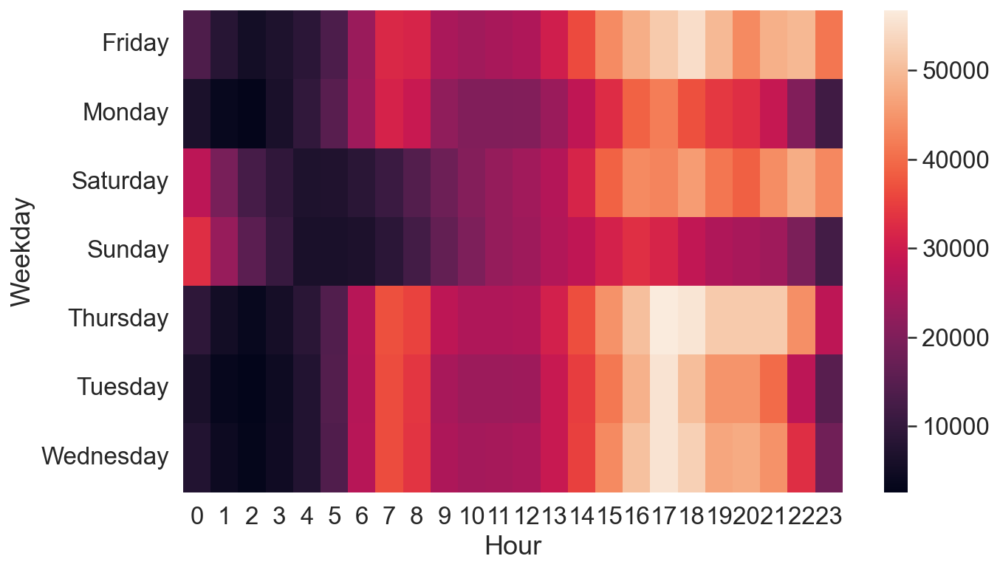

In [30]:
plt.figure(figsize=(10,6))
sns.heatmap(pivot, annot=False)

#### __The Information What I Get:__
* The closer it is to the end of the afternoon, the busier Uber pick up will be
* The lowest point in the number of uber pickups occurred at midnight specifically on weekdays
* But on weekends ( saturday & sunday), the number of uber pick up at midnight is more than weekdays. This shows that on weekends there are still more travel activities than weekdays
* at 9-12 am, there is almost no difference in the number of Uber pick-ups on weekends or weekdays

In [31]:
# define heatmap function

def heatmap(col1, col2):
    by_cross = df.groupby([col1,col2]).apply(lambda x: len(x))
    pivot = by_cross.unstack()
    plt.figure(figsize=(10,6))
    sns.heatmap(pivot, annot=False)

## Heatmap by Month and Day

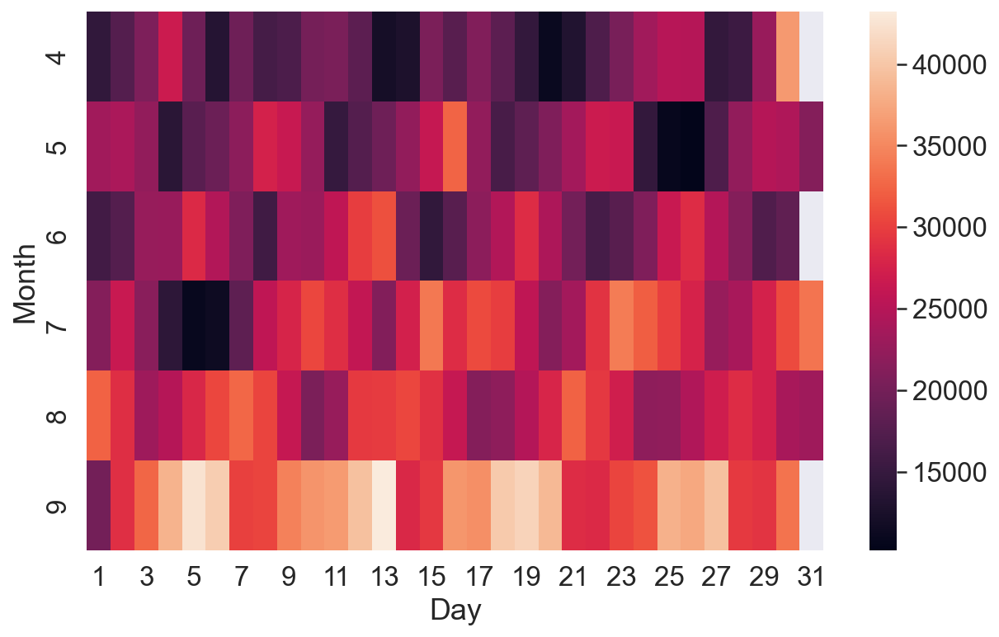

In [32]:
heatmap('Month','Day')

#### __The Information What I Get:__

  We Observe that the number of trips increases each month, we can say that from april to september 2014, Uber was in a continuous improvement process

## ANALYSIS OF LOCATION DATA POINT

#### What I Do is:

* Using Spatial analysis with heatmap to get insight from pick up location spread
* Define a function that create spatial analysis for spesific day

In [33]:
import folium
from folium.plugins import HeatMap

In [34]:
df.head()

,Date/Time,Lat,Lon,Base,Weekday,Day,Month,Minute,Hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,9,1,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,9,1,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,9,3,0
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,9,6,0
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,9,11,0


In [35]:
df_out=df[df['Weekday']=='Sunday']
df_out.head()

,Date/Time,Lat,Lon,Base,Weekday,Day,Month,Minute,Hour
8011,2014-09-07 00:00:00,40.7341,-74.0005,B02512,Sunday,7,9,0,0
8012,2014-09-07 00:00:00,40.7344,-73.9900,B02512,Sunday,7,9,0,0
8013,2014-09-07 00:00:00,40.7806,-73.9582,B02512,Sunday,7,9,0,0
8014,2014-09-07 00:01:00,40.7293,-73.9859,B02512,Sunday,7,9,1,0
8015,2014-09-07 00:01:00,40.7713,-74.0133,B02512,Sunday,7,9,1,0


In [36]:
pickUpLoc= df_out.groupby(['Lat','Lon'])['Weekday'].count().reset_index()
pickUpLoc

,Lat,Lon,Weekday
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1
...,...,...,...
209225,41.3141,-74.1249,1
209226,41.3180,-74.1298,1
209227,41.3195,-73.6905,1
209228,41.3197,-73.6903,1


In [37]:
basemap = folium.Map()
#basemap

In [38]:
HeatMap(pickUpLoc, zoom=20, radius=15).add_to(basemap)
basemap

#### __The Information What I Get:__

And from this analysis, we can definitely come up with this insight. Look at my midtown Manhattan, And this is exactly a huge bright is what it means this location have a maximum number of pickup uber

So whenever a user is going to Mindtown Manhattan from this particular zone so we can offer some discount to increase my sales.


In [39]:
# Define a function
def plotSpatial(df, day):
    slicingDF = df.loc[df['Weekday']== day]
    dataHeatMap = slicingDF.groupby(['Lat', 'Lon'])['Weekday'].count().reset_index()
    HeatMap(dataHeatMap, zoom=20, radius=15).add_to(basemap)
    return basemap

In [40]:
plotSpatial(df, 'Monday')

## ANALYSIS OF JAN - JUNE 2015

#### What I Do:
* Check whether missing data
* Change format date time
* Add new column, to get easier for analysis 

In [41]:
uber2015 = pd.read_csv(r'C:\Users\Robby\Project\Project\Project-III\Dataset\uber-pickups-in-new-york-city\uber-raw-data-janjune-15.csv')
uber2015.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [42]:
uber2015.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14270479 entries, 0 to 14270478
Data columns (total 4 columns):
 #   Column                Dtype 
---  ------                ----- 
 0   Dispatching_base_num  object
 1   Pickup_date           object
 2   Affiliated_base_num   object
 3   locationID            int64 
dtypes: int64(1), object(3)
memory usage: 435.5+ MB


In [43]:
uber2015['Pickup_date'].min()

'2015-01-01 00:00:05'

In [44]:
uber2015['Pickup_date'].max()

'2015-06-30 23:59:00'

#### __The Information What I Get:__

* This data is taken __starting from the date *'2015-01-01'* until *2015-06-30*__
* and has a __total data of 14.270.479 row__

In [45]:
# change a format date
uber2015['Pickup_date'] = pd.to_datetime(uber2015['Pickup_date'], format='%Y-%m-%d %H:%M:%S')

In [46]:
# create a new column
uber2015['Weekday'] = uber2015['Pickup_date'].dt.day_name()
uber2015['Day'] = uber2015['Pickup_date'].dt.day
uber2015['Month'] = uber2015['Pickup_date'].dt.month
uber2015['Hour'] = uber2015['Pickup_date'].dt.hour
uber2015['Minute'] = uber2015['Pickup_date'].dt.minute

In [47]:
# final data
uber2015.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,Weekday,Day,Month,Hour,Minute
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,5,9,47
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,5,9,47
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,5,9,47
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,5,9,47
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,5,9,47


In [48]:
# final data
uber2015.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14270479 entries, 0 to 14270478
Data columns (total 9 columns):
 #   Column                Dtype         
---  ------                -----         
 0   Dispatching_base_num  object        
 1   Pickup_date           datetime64[ns]
 2   Affiliated_base_num   object        
 3   locationID            int64         
 4   Weekday               object        
 5   Day                   int64         
 6   Month                 int64         
 7   Hour                  int64         
 8   Minute                int64         
dtypes: datetime64[ns](1), int64(5), object(3)
memory usage: 979.9+ MB


## ANALYSIS BY THE MONTH IN NYC

#### What I Do Is:

to find out which month in 2015 have the maximum total number of pick up

In [49]:
trace1 = go.Bar( 
        x = uber2015.groupby('Month')['Hour'].sum().index,
        y = uber2015.groupby('Month')['Hour'].sum(),
        name= 'Priority')
ax = iplot([trace1])

#### The Information What I Get:

When compered with the data from 2014, the total of uber pick up in 2015 has significantly increased. It is certain that throughout 2014, uber continued to improve its quality and succeeded in attracting more consumers

## ANALYSING OF TOTAL TRIP PER HOUR

C:\Users\Robby\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



Text(0.5, 1.0, 'Total Trip Uber 2015 in Hour')

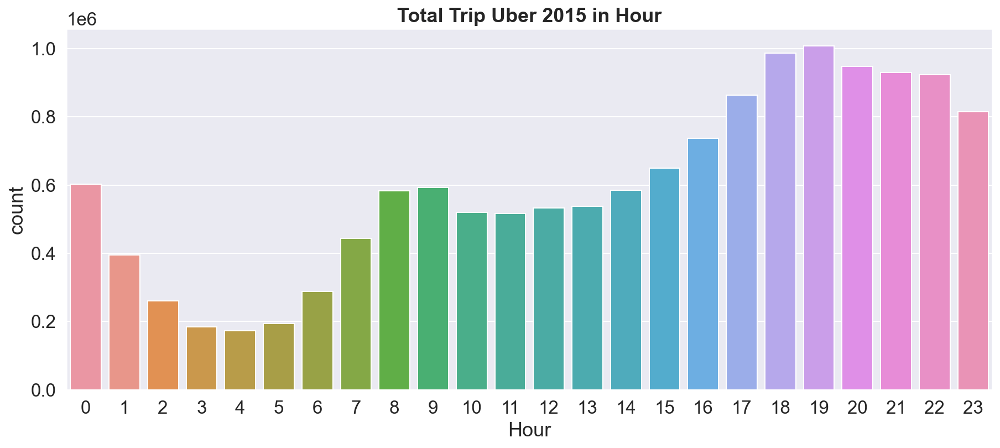

In [50]:
#countplot is used to sum data by category.
plt.figure(figsize=(15,6))
ax=sns.countplot(uber2015['Hour'])
ax.set_title('Total Trip Uber 2015 in Hour', fontweight='bold')

#### __The Information What I Get:__

* There is no significant change in the total trip of uber at 8-10
* Signifincantly more demand in the evening

## ANALYSIS IN DEPTH ANALYSIS OF RUSH IN NEW YORK CITY DAY & HOUR WISE

In [51]:
summary = uber2015.groupby(['Weekday', 'Hour'])['Pickup_date'].count().reset_index()
summary.rename(columns= {'Pickup_date':'Counts'}, inplace=True)
summary.head()

,Weekday,Hour,Counts
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


<AxesSubplot:xlabel='Hour', ylabel='Counts'>

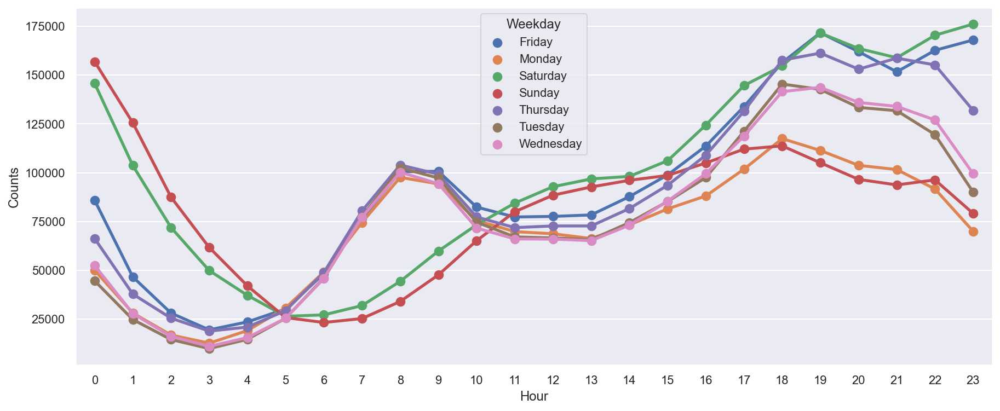

In [52]:
plt.figure(figsize=(15,6))
sns.set(font_scale=1)

sns.pointplot(x='Hour',
              y= 'Counts',
              hue='Weekday',
              data=summary)

#### __The Information What I Get:__
* On Friday and Saturday, the closer the time goes to midnight, the higher the total number of Uber Trips
* On Saturday and Sunday, the total number of Uber trips between 7-10 am is not as high as on other days. Because its weekend, so only a few people go to work

## ANALYSIS ANOTHER DATASET

#### What I Do:
So i want analysis another dataset, to get more insight from uber data. What to find out is:
* Which base number has most active vehicles
* Which base number has most trips
* How average trip/vehicle increse/decrease with dates with each of base number

In [53]:
uberFoil =pd.read_csv(r"C:\Users\Robby\Project\Project\Project-III\Dataset\uber-pickups-in-new-york-city\Uber-Jan-Feb-FOIL.csv")
uberFoil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


<AxesSubplot:xlabel='dispatching_base_number', ylabel='active_vehicles'>

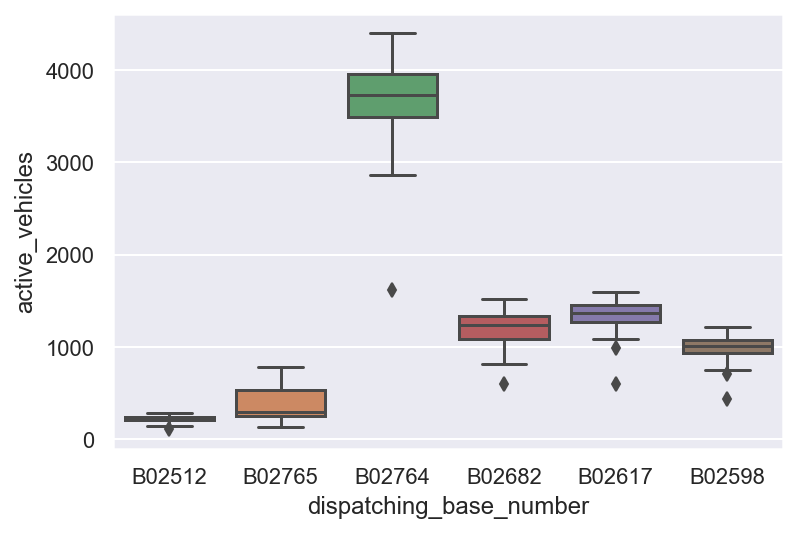

In [54]:
sns.boxplot(x='dispatching_base_number',
            y='active_vehicles',
            data=uberFoil)

<AxesSubplot:xlabel='dispatching_base_number', ylabel='trips'>

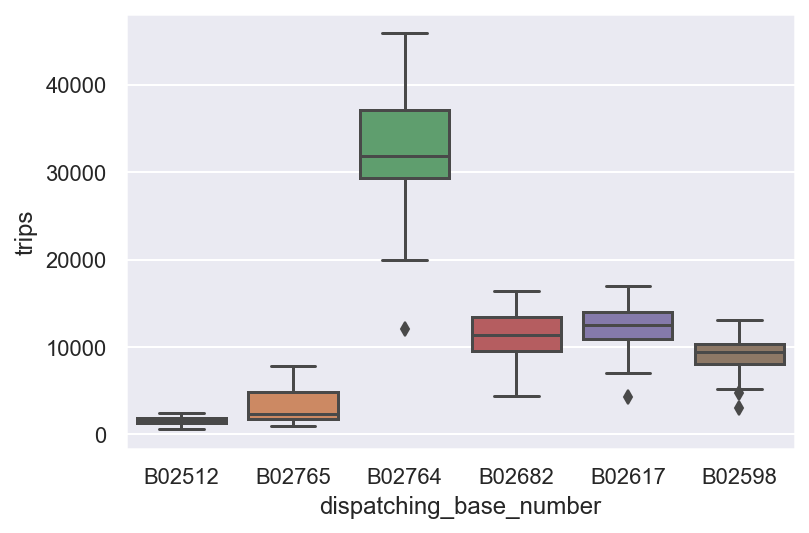

In [55]:
sns.boxplot(x = 'dispatching_base_number', y = 'trips', data = uberFoil)

#### __The Information What I Get:__

Base **B02764** has a maximum number of active vehicles and number of trips

In [56]:
uberFoil['trips/vehicle']= uberFoil['trips']/uberFoil['active_vehicles']
uberFoil_dateIndex = uberFoil.set_index('date')
uberFoil_dateIndex

,dispatching_base_number,active_vehicles,trips,trips/vehicle
date,,,,
1/1/2015,B02512,190,1132,5.957895
1/1/2015,B02765,225,1765,7.844444
1/1/2015,B02764,3427,29421,8.585060
1/1/2015,B02682,945,7679,8.125926
1/1/2015,B02617,1228,9537,7.766287
...,...,...,...,...
2/28/2015,B02764,3952,39812,10.073887
2/28/2015,B02617,1372,14022,10.220117
2/28/2015,B02682,1386,14472,10.441558


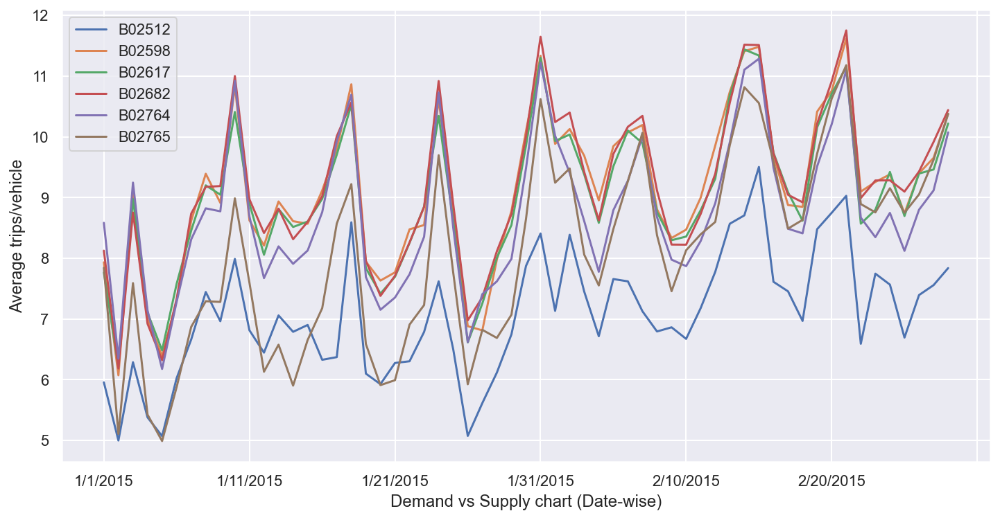

In [57]:
plt.figure(figsize=(12,6))
uberFoil_dateIndex.groupby(['dispatching_base_number'])['trips/vehicle'].plot()
plt.ylabel('Average trips/vehicle')
plt.xlabel('Demand vs Supply chart (Date-wise)')
plt.legend()
                            

#### __The Information What I Get:__
* Orange plot(B02598) and purple plot(B02764) It means both these base number, which is they definitely performed better.
* Blue plot(B02512),it doesn't have that much good attention comparing to all other space number.